In [1]:
!pip install kiwipiepy

In [2]:
# colab : !wget -c https://github.com/e9t/nsmc/raw/master/ratings_train.txt
import wget

wget.download('https://github.com/e9t/nsmc/raw/master/ratings_train.txt')

'ratings_train.txt'

### 데이터 확인

In [3]:
import pandas as pd

# nsmc = pd.read_csv(r'./ratings_train.txt', header=None, sep = ',', error_bad_lines = False)
# nsmc = pd.read_table('./ratings_train.txt')
nsmc = pd.read_csv('./ratings_train.txt', sep = '\t')
nsmc

,id,document,label
0,9976970,아 더빙.. 진짜 짜증나네요 목소리,0
1,3819312,흠...포스터보고 초딩영화줄....오버연기조차 가볍지 않구나,1
2,10265843,너무재밓었다그래서보는것을추천한다,0
3,9045019,교도소 이야기구먼 ..솔직히 재미는 없다..평점 조정,0
4,6483659,사이몬페그의 익살스런 연기가 돋보였던 영화!스파이더맨에서 늙어보이기만 했던 커스틴 ...,1
...,...,...,...
149995,6222902,인간이 문제지.. 소는 뭔죄인가..,0
149996,8549745,평점이 너무 낮아서...,1
149997,9311800,이게 뭐요? 한국인은 거들먹거리고 필리핀 혼혈은 착하다?,0
149998,2376369,청춘 영화의 최고봉.방황과 우울했던 날들의 자화상,1


### 형태소 분석

In [4]:
from kiwipiepy import Kiwi

kiwi = Kiwi()
kiwi.prepare()

In [5]:
text = nsmc.document[0]
text

'아 더빙.. 진짜 짜증나네요 목소리'

In [6]:
result = kiwi.analyze(text)
result

[([Token(form='아', tag='IC', start=0, len=1),
   Token(form='더빙', tag='NNG', start=2, len=2),
   Token(form='..', tag='SF', start=4, len=2),
   Token(form='진짜', tag='MAG', start=7, len=2),
   Token(form='짜증', tag='NNG', start=10, len=2),
   Token(form='나', tag='VV', start=12, len=1),
   Token(form='네요', tag='EF', start=13, len=2),
   Token(form='목소리', tag='NNG', start=16, len=3)],
  -70.44538879394531)]

In [7]:
result1 = kiwi.analyze(nsmc.document)
result1

In [8]:
a = 0

try:
    for idx, x in enumerate(result1):
        print(x)
        a = idx
    print(a)
except:
    pass

[([Token(form='아', tag='IC', start=0, len=1), Token(form='더빙', tag='NNG', start=2, len=2), Token(form='..', tag='SF', start=4, len=2), Token(form='진짜', tag='MAG', start=7, len=2), Token(form='짜증', tag='NNG', start=10, len=2), Token(form='나', tag='VV', start=12, len=1), Token(form='네요', tag='EF', start=13, len=2), Token(form='목소리', tag='NNG', start=16, len=3)], -70.44538879394531)]
[([Token(form='흠', tag='IC', start=0, len=1), Token(form='...', tag='SF', start=1, len=3), Token(form='포스터', tag='NNG', start=4, len=3), Token(form='보', tag='VV', start=7, len=1), Token(form='고', tag='EC', start=8, len=1), Token(form='초딩', tag='NNP', start=10, len=2), Token(form='영화', tag='NNG', start=12, len=2), Token(form='줄', tag='NNG', start=14, len=1), Token(form='....', tag='SF', start=15, len=4), Token(form='오버', tag='NNG', start=19, len=2), Token(form='연기', tag='NNG', start=21, len=2), Token(form='조차', tag='JX', start=23, len=2), Token(form='가볍', tag='VA-I', start=26, len=2), Token(form='지', tag='EC',

In [9]:
result[0][0]

[Token(form='아', tag='IC', start=0, len=1),
 Token(form='더빙', tag='NNG', start=2, len=2),
 Token(form='..', tag='SF', start=4, len=2),
 Token(form='진짜', tag='MAG', start=7, len=2),
 Token(form='짜증', tag='NNG', start=10, len=2),
 Token(form='나', tag='VV', start=12, len=1),
 Token(form='네요', tag='EF', start=13, len=2),
 Token(form='목소리', tag='NNG', start=16, len=3)]

In [10]:
for token, pos, start, end in result[0][0]:
    if pos in ['NNG', 'VV', 'VA']:
        print(token)

더빙
짜증
나
목소리


In [11]:
for token, pos, start, end in result[0][0]:
    if pos[0] in 'NV':
        print(f'{token} / {pos}')

더빙 / NNG
짜증 / NNG
나 / VV
목소리 / NNG


In [12]:
def extract_keywords(text):
    result = kiwi.analyze(text)
    for token, pos, _, _ in result[0][0]:
        if pos[0] in 'NV':
            yield f'{token}/{pos}'

In [13]:
list(extract_keywords(nsmc.document[1]))

['포스터/NNG',
 '보/VV',
 '초딩/NNP',
 '영화/NNG',
 '줄/NNG',
 '오버/NNG',
 '연기/NNG',
 '가볍/VA-I',
 '않/VX']

### 문서 단어 행렬

In [14]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer

In [15]:
cv = CountVectorizer(max_features=1000, tokenizer=extract_keywords)

In [16]:
dtm = cv.fit_transform(nsmc.loc[0:1999, 'document'])

In [17]:
trans = TfidfTransformer()
dtm2 = trans.fit_transform(dtm)

In [18]:
dtm.shape

(2000, 1000)

In [20]:
words = cv.get_feature_names()
words

['가/VV',
 '가/VX',
 '가능/NNG',
 '가볍/VA-I',
 '가슴/NNG',
 '가족/NNG',
 '가지/NNB',
 '가지/VV',
 '가치/NNG',
 '각본/NNG',
 '간/NNB',
 '갈등/NNG',
 '감독/NNG',
 '감동/NNG',
 '감사/NNG',
 '감성/NNG',
 '감정/NNG',
 '강요/NNG',
 '강하/VA',
 '같/VA',
 '개/NNB',
 '개/NNG',
 '개그/NNG',
 '개그맨/NNG',
 '개념/NNG',
 '개봉/NNG',
 '개뿔/NNG',
 '개연/NNG',
 '개인/NNG',
 '개판/NNG',
 '거/NNB',
 '거기/NP',
 '거리/NNG',
 '거리/VV',
 '거부/NNG',
 '거슬리/VV',
 '거장/NNG',
 '걱정/NNG',
 '걸/VV',
 '걸리/VV',
 '걸작/NNG',
 '검술/NNG',
 '것/NNB',
 '게이/NNG',
 '게임/NNG',
 '결국/NNG',
 '결말/NNG',
 '고추/NNG',
 '곳/NNG',
 '곳곳/NNG',
 '공감/NNG',
 '공감/NNP',
 '공부/NNG',
 '공포/NNG',
 '공포물/NNG',
 '곽지민/NNP',
 '관객/NNG',
 '관계/NNG',
 '관람/NNG',
 '관심/NNG',
 '괜찮/VA',
 '교훈/NNG',
 '구경/NNG',
 '구리/VA',
 '구성/NNG',
 '구하/VV',
 '국민/NNG',
 '국산/NNG',
 '군/NNG',
 '군대/NNG',
 '굿/NNG',
 '굿/NNP',
 '귀신/NNG',
 '귀엽/VA-I',
 '그/NP',
 '그거/NP',
 '그것/NP',
 '그녀/NP',
 '그때/NNG',
 '그래픽/NNG',
 '그러/VV',
 '그렇/VA',
 '그리/VV',
 '그림/NNG',
 '그립/VA-I',
 '극/NNG',
 '극장/NNG',
 '극장판/NNG',
 '글/NNG',
 '급/NNG',
 '기/NNG',
 '기대/NNG',
 '기독교/NNG',
 '기분/

### 저장

In [21]:
import joblib

joblib.dump({'words': words, 'dtm':dtm}, 'nsmc.pkl')

['nsmc.pkl']

### train_test_split

In [22]:
import joblib

data = joblib.load('nsmc.pkl')

In [23]:
data['words']

['가/VV',
 '가/VX',
 '가능/NNG',
 '가볍/VA-I',
 '가슴/NNG',
 '가족/NNG',
 '가지/NNB',
 '가지/VV',
 '가치/NNG',
 '각본/NNG',
 '간/NNB',
 '갈등/NNG',
 '감독/NNG',
 '감동/NNG',
 '감사/NNG',
 '감성/NNG',
 '감정/NNG',
 '강요/NNG',
 '강하/VA',
 '같/VA',
 '개/NNB',
 '개/NNG',
 '개그/NNG',
 '개그맨/NNG',
 '개념/NNG',
 '개봉/NNG',
 '개뿔/NNG',
 '개연/NNG',
 '개인/NNG',
 '개판/NNG',
 '거/NNB',
 '거기/NP',
 '거리/NNG',
 '거리/VV',
 '거부/NNG',
 '거슬리/VV',
 '거장/NNG',
 '걱정/NNG',
 '걸/VV',
 '걸리/VV',
 '걸작/NNG',
 '검술/NNG',
 '것/NNB',
 '게이/NNG',
 '게임/NNG',
 '결국/NNG',
 '결말/NNG',
 '고추/NNG',
 '곳/NNG',
 '곳곳/NNG',
 '공감/NNG',
 '공감/NNP',
 '공부/NNG',
 '공포/NNG',
 '공포물/NNG',
 '곽지민/NNP',
 '관객/NNG',
 '관계/NNG',
 '관람/NNG',
 '관심/NNG',
 '괜찮/VA',
 '교훈/NNG',
 '구경/NNG',
 '구리/VA',
 '구성/NNG',
 '구하/VV',
 '국민/NNG',
 '국산/NNG',
 '군/NNG',
 '군대/NNG',
 '굿/NNG',
 '굿/NNP',
 '귀신/NNG',
 '귀엽/VA-I',
 '그/NP',
 '그거/NP',
 '그것/NP',
 '그녀/NP',
 '그때/NNG',
 '그래픽/NNG',
 '그러/VV',
 '그렇/VA',
 '그리/VV',
 '그림/NNG',
 '그립/VA-I',
 '극/NNG',
 '극장/NNG',
 '극장판/NNG',
 '글/NNG',
 '급/NNG',
 '기/NNG',
 '기대/NNG',
 '기독교/NNG',
 '기분/

In [24]:
words = ''

In [25]:
words

''

In [26]:
locals().update(data) # locals()는 dict.key()값으로 변수를 만들어주는 함수!

In [27]:
words

['가/VV',
 '가/VX',
 '가능/NNG',
 '가볍/VA-I',
 '가슴/NNG',
 '가족/NNG',
 '가지/NNB',
 '가지/VV',
 '가치/NNG',
 '각본/NNG',
 '간/NNB',
 '갈등/NNG',
 '감독/NNG',
 '감동/NNG',
 '감사/NNG',
 '감성/NNG',
 '감정/NNG',
 '강요/NNG',
 '강하/VA',
 '같/VA',
 '개/NNB',
 '개/NNG',
 '개그/NNG',
 '개그맨/NNG',
 '개념/NNG',
 '개봉/NNG',
 '개뿔/NNG',
 '개연/NNG',
 '개인/NNG',
 '개판/NNG',
 '거/NNB',
 '거기/NP',
 '거리/NNG',
 '거리/VV',
 '거부/NNG',
 '거슬리/VV',
 '거장/NNG',
 '걱정/NNG',
 '걸/VV',
 '걸리/VV',
 '걸작/NNG',
 '검술/NNG',
 '것/NNB',
 '게이/NNG',
 '게임/NNG',
 '결국/NNG',
 '결말/NNG',
 '고추/NNG',
 '곳/NNG',
 '곳곳/NNG',
 '공감/NNG',
 '공감/NNP',
 '공부/NNG',
 '공포/NNG',
 '공포물/NNG',
 '곽지민/NNP',
 '관객/NNG',
 '관계/NNG',
 '관람/NNG',
 '관심/NNG',
 '괜찮/VA',
 '교훈/NNG',
 '구경/NNG',
 '구리/VA',
 '구성/NNG',
 '구하/VV',
 '국민/NNG',
 '국산/NNG',
 '군/NNG',
 '군대/NNG',
 '굿/NNG',
 '굿/NNP',
 '귀신/NNG',
 '귀엽/VA-I',
 '그/NP',
 '그거/NP',
 '그것/NP',
 '그녀/NP',
 '그때/NNG',
 '그래픽/NNG',
 '그러/VV',
 '그렇/VA',
 '그리/VV',
 '그림/NNG',
 '그립/VA-I',
 '극/NNG',
 '극장/NNG',
 '극장판/NNG',
 '글/NNG',
 '급/NNG',
 '기/NNG',
 '기대/NNG',
 '기독교/NNG',
 '기분/

In [29]:
dtm

<2000x1000 sparse matrix of type '<class 'numpy.int64'>'
	with 12520 stored elements in Compressed Sparse Row format>

In [34]:
# !wget -c https://github.com/e9t/nsmc/raw/master/ratings_train.txt # colab
import wget

wget.download('https://github.com/e9t/nsmc/raw/master/ratings_train.txt')

'ratings_train (1).txt'

In [35]:
import pandas as pd

nsmc = pd.read_csv('./ratings_train.txt', sep = '\t')

In [36]:
from sklearn.model_selection import train_test_split

In [37]:
x = dtm
y = nsmc.label.values[:2000]

In [38]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=1984)

### 로지스틱 회귀 분석

#### 모형 정의

In [40]:
import tensorflow as tf

model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Dense(1, activation = 'sigmoid'))

2022-10-31 14:23:27.780676: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2022-10-31 14:23:27.780730: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2022-10-31 14:23:27.780758: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (jeon2slaptop): /proc/driver/nvidia/version does not exist
2022-10-31 14:23:27.781723: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


#### 설정

In [41]:
model.compile(optimizer='adam', loss = 'binary_crossentropy', metrics=['accuracy'])

#### 훈련

In [43]:
x_train # 압축되어 있음

<1600x1000 sparse matrix of type '<class 'numpy.int64'>'
	with 9984 stored elements in Compressed Sparse Row format>

In [44]:
x_train.A

array([[1, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [45]:
x_train.A.shape # 문서가 1600개, 단어가 1000개

(1600, 1000)

In [42]:
model.fit(x_train.A, y_train, epochs=3)

Epoch 1/3
50/50 [==============================] - 1s 2ms/step - loss: 0.6860 - accuracy: 0.5487
Epoch 2/3
50/50 [==============================] - 0s 3ms/step - loss: 0.6697 - accuracy: 0.6587
Epoch 3/3
50/50 [==============================] - 0s 2ms/step - loss: 0.6549 - accuracy: 0.7119


#### 테스트

In [46]:
model.evaluate(x_test.A, y_test)

13/13 [==============================] - 0s 4ms/step - loss: 0.6625 - accuracy: 0.6450


[0.6624516248703003, 0.6449999809265137]

#### 저장

In [47]:
model.save('nsmc.krs')

INFO:tensorflow:Assets written to: nsmc.krs/assets


### 가중치 분석

#### 모형 불러오기

In [48]:
import tensorflow as tf

model = tf.keras.models.load_model('nsmc.krs')

#### 파라미터

In [49]:
w, b = model.weights

In [51]:
w

<tf.Variable 'dense/kernel:0' shape=(1000, 1) dtype=float32, numpy=
array([[-7.28519335e-02],
       [ 4.03509960e-02],
       [ 7.40627199e-02],
       [-2.43225899e-02],
       [ 8.37151557e-02],
       [ 7.33617842e-02],
       [-4.76813614e-02],
       [ 7.86504820e-02],
       [ 1.30892303e-02],
       [-6.60176799e-02],
       [-2.15557311e-02],
       [-6.68808445e-02],
       [-8.72719213e-02],
       [ 4.67730276e-02],
       [-5.10719307e-02],
       [-5.53973913e-02],
       [ 1.75492335e-02],
       [-2.01626904e-02],
       [-1.78097263e-02],
       [-2.32515894e-02],
       [-1.47870108e-01],
       [-8.56897533e-02],
       [-9.35011581e-02],
       [-8.18559453e-02],
       [ 1.66548300e-03],
       [-6.75486922e-02],
       [ 4.34900448e-02],
       [-4.74433526e-02],
       [ 9.02055502e-02],
       [ 3.25597562e-02],
       [-6.32023141e-02],
       [-1.81837566e-02],
       [ 1.55870030e-02],
       [-4.05645333e-02],
       [ 3.17199714e-02],
       [-6.50645718e-0

#### 단어별 가중치

In [53]:
w.numpy() # 양의 값이면 단어가 많이 나올수록 긍정, 반대면 부정일 확률이 높음

array([[-7.28519335e-02],
       [ 4.03509960e-02],
       [ 7.40627199e-02],
       [-2.43225899e-02],
       [ 8.37151557e-02],
       [ 7.33617842e-02],
       [-4.76813614e-02],
       [ 7.86504820e-02],
       [ 1.30892303e-02],
       [-6.60176799e-02],
       [-2.15557311e-02],
       [-6.68808445e-02],
       [-8.72719213e-02],
       [ 4.67730276e-02],
       [-5.10719307e-02],
       [-5.53973913e-02],
       [ 1.75492335e-02],
       [-2.01626904e-02],
       [-1.78097263e-02],
       [-2.32515894e-02],
       [-1.47870108e-01],
       [-8.56897533e-02],
       [-9.35011581e-02],
       [-8.18559453e-02],
       [ 1.66548300e-03],
       [-6.75486922e-02],
       [ 4.34900448e-02],
       [-4.74433526e-02],
       [ 9.02055502e-02],
       [ 3.25597562e-02],
       [-6.32023141e-02],
       [-1.81837566e-02],
       [ 1.55870030e-02],
       [-4.05645333e-02],
       [ 3.17199714e-02],
       [-6.50645718e-02],
       [-3.68565954e-02],
       [-2.34366162e-04],
       [-2.2

In [54]:
import pandas as pd

word_sent = pd.DataFrame({'토큰': words, '가중치': w.numpy().flat})
word_sent

,토큰,가중치
0,가/VV,-0.072852
1,가/VX,0.040351
2,가능/NNG,0.074063
3,가볍/VA-I,-0.024323
4,가슴/NNG,0.083715
...,...,...
995,흥미/NNG,0.010212
996,흥미진진하/VA,-0.021310
997,흥행/NNG,0.037032
998,희망/NNG,0.031921


#### 긍정단어

In [56]:
word_sent.sort_values('가중치').tail(10)

,토큰,가중치
937,편/NNG,0.105284
491,수작/NNG,0.105755
395,보내/VV,0.105970
750,재미있/VA,0.106383
943,평론가/NNG,0.106841
63,구리/VA,0.109815
124,나이/NNG,0.111807
138,낮/VA,0.112531
392,보/VV,0.115449
73,귀엽/VA-I,0.138646


#### 부정단어

In [57]:
word_sent.sort_values('가중치').head(10)

,토큰,가중치
20,개/NNB,-0.147870
160,높/VA,-0.145970
543,아깝/VA-I,-0.145764
856,짜증/NNG,-0.127528
537,쓰/VV,-0.124843
143,내용/NNG,-0.123363
281,맞/VV,-0.111357
889,최악/NNG,-0.110584
311,몸매/NNG,-0.109434
439,산/NNG,-0.109334


### 희소 행렬 변환(SparseTensor)

In [59]:
x_train

<1600x1000 sparse matrix of type '<class 'numpy.int64'>'
	with 9984 stored elements in Compressed Sparse Row format>

In [60]:
#model.fit(x_train.A) # tensorflow의 coo 포맷(희소행렬 압축 방식. 0이 아닌 값을 행, 열, 값으로 저장)

In [58]:
type(x_train) # 압축된 scipy의 csr 포맷(값, 열, 행을 별도로 저장). 학습시키기 전에 포맷을 맞춰야 함(csr -> coo)

scipy.sparse._csr.csr_matrix

In [61]:
tf.SparseTensor # scipy 행렬을 나타내는 방법

tensorflow.python.framework.sparse_tensor.SparseTensor

In [62]:
x_coo = x_train.tocoo()

In [67]:
print(x_coo.shape)
type(x_coo)

(1600, 1000)


scipy.sparse._coo.coo_matrix

In [64]:
x_coo.row # 1599 행의

array([   0,    0,    0, ..., 1599, 1599, 1599], dtype=int32)

In [65]:
x_coo.col # 955 열의

array([  0, 122, 143, ..., 746, 956, 957], dtype=int32)

In [66]:
x_coo.data # 값은 7이다

array([1, 1, 1, ..., 1, 1, 7])

In [68]:
import numpy as np

index = np.column_stack([x_coo.row, x_coo.col])
index

array([[   0,    0],
       [   0,  122],
       [   0,  143],
       ...,
       [1599,  746],
       [1599,  956],
       [1599,  957]], dtype=int32)

In [69]:
x_train_sparse = tf.SparseTensor(index, x_coo.data, x_coo.shape)

In [70]:
x_train_sparse = tf.sparse.reorder(x_train_sparse) # 재정렬

In [71]:
model.fit(x_train_sparse, y_train, epochs=2)

Epoch 1/2


/home/jeon2/anaconda3/envs/study/lib/python3.10/site-packages/tensorflow/python/framework/indexed_slices.py:444: UserWarning: Converting sparse IndexedSlices(IndexedSlices(indices=Tensor("gradient_tape/sequential/dense/embedding_lookup_sparse/Reshape_1:0", shape=(None,), dtype=int32), values=Tensor("gradient_tape/sequential/dense/embedding_lookup_sparse/Reshape:0", shape=(None, 1), dtype=float32), dense_shape=Tensor("gradient_tape/sequential/dense/embedding_lookup_sparse/Cast:0", shape=(2,), dtype=int32))) to a dense Tensor of unknown shape. This may consume a large amount of memory.
  warnings.warn(


50/50 [==============================] - 2s 5ms/step - loss: 0.6414 - accuracy: 0.7456
Epoch 2/2
50/50 [==============================] - 0s 4ms/step - loss: 0.6273 - accuracy: 0.7681


### Early Stopping

In [72]:
from sklearn.model_selection import train_test_split

x = dtm
y = nsmc.label.values[:2000]

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=1984)

In [73]:
import tensorflow as tf

model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Dense(1, activation='sigmoid'))

In [74]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [75]:
history = model.fit(x_train.A, y_train, epochs=100, validation_split=0.1)

Epoch 1/100
45/45 [==============================] - 1s 8ms/step - loss: 0.6914 - accuracy: 0.5146 - val_loss: 0.6920 - val_accuracy: 0.5125
Epoch 2/100
45/45 [==============================] - 0s 6ms/step - loss: 0.6753 - accuracy: 0.6146 - val_loss: 0.6799 - val_accuracy: 0.5875
Epoch 3/100
45/45 [==============================] - 0s 4ms/step - loss: 0.6611 - accuracy: 0.6812 - val_loss: 0.6690 - val_accuracy: 0.6625
Epoch 4/100
45/45 [==============================] - 0s 4ms/step - loss: 0.6476 - accuracy: 0.7188 - val_loss: 0.6581 - val_accuracy: 0.6750
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 0.6353 - accuracy: 0.7583 - val_loss: 0.6489 - val_accuracy: 0.7000
Epoch 6/100
45/45 [==============================] - 0s 4ms/step - loss: 0.6234 - accuracy: 0.7750 - val_loss: 0.6401 - val_accuracy: 0.7250
Epoch 7/100
45/45 [==============================] - 0s 7ms/step - loss: 0.6125 - accuracy: 0.7931 - val_loss: 0.6316 - val_accuracy: 0.7312
Epoch 8/100
4

In [76]:
len(history.history['loss'])

100

In [79]:
history.history['loss']

[0.6914026141166687,
 0.6753110885620117,
 0.6610667705535889,
 0.6476081013679504,
 0.6352753639221191,
 0.6234487295150757,
 0.6124641299247742,
 0.6020434498786926,
 0.5920262932777405,
 0.582696259021759,
 0.5738922357559204,
 0.5655350685119629,
 0.557396411895752,
 0.5497593283653259,
 0.542352020740509,
 0.535295844078064,
 0.5286499261856079,
 0.5220829248428345,
 0.515855610370636,
 0.5098976492881775,
 0.5041268467903137,
 0.4985842704772949,
 0.49319425225257874,
 0.4879762530326843,
 0.48292288184165955,
 0.4780835509300232,
 0.4733864665031433,
 0.46879225969314575,
 0.464433878660202,
 0.4600730836391449,
 0.45587000250816345,
 0.4518217444419861,
 0.44783955812454224,
 0.44394463300704956,
 0.4402373135089874,
 0.4366457760334015,
 0.4329851269721985,
 0.4294617474079132,
 0.42609483003616333,
 0.4227391481399536,
 0.4194905459880829,
 0.41634419560432434,
 0.4132610261440277,
 0.41018345952033997,
 0.40726497769355774,
 0.40435218811035156,
 0.40147408843040466,
 0.3987

In [77]:
history.history['val_loss']

[0.6919569969177246,
 0.6798848509788513,
 0.6690133810043335,
 0.6581447124481201,
 0.6488997340202332,
 0.6401366591453552,
 0.631621241569519,
 0.6237490773200989,
 0.6169624328613281,
 0.6099171042442322,
 0.6034674644470215,
 0.5977246761322021,
 0.5924288034439087,
 0.5871272683143616,
 0.5822769999504089,
 0.5778617858886719,
 0.5733174085617065,
 0.5691680908203125,
 0.5654153227806091,
 0.5616686344146729,
 0.5583139657974243,
 0.5552009344100952,
 0.5519495010375977,
 0.5491629838943481,
 0.546404242515564,
 0.543603777885437,
 0.5411402583122253,
 0.5388180017471313,
 0.536648154258728,
 0.5345407724380493,
 0.532261073589325,
 0.5308933258056641,
 0.5286568403244019,
 0.5269827246665955,
 0.525519847869873,
 0.5233618021011353,
 0.5225040316581726,
 0.5207967162132263,
 0.5196870565414429,
 0.5183858275413513,
 0.517088770866394,
 0.5160708427429199,
 0.5151033997535706,
 0.5140652656555176,
 0.5129286646842957,
 0.5116569399833679,
 0.5112109184265137,
 0.5103188753128052,

In [78]:
history.history['accuracy']

[0.5145833492279053,
 0.6145833134651184,
 0.6812499761581421,
 0.71875,
 0.7583333253860474,
 0.7749999761581421,
 0.793055534362793,
 0.8055555820465088,
 0.8104166388511658,
 0.8222222328186035,
 0.8354166746139526,
 0.8388888835906982,
 0.8423610925674438,
 0.8458333611488342,
 0.8486111164093018,
 0.8506944179534912,
 0.8534722328186035,
 0.8548611402511597,
 0.8597221970558167,
 0.8604166507720947,
 0.8638888597488403,
 0.8659722208976746,
 0.8652777671813965,
 0.8694444298744202,
 0.8687499761581421,
 0.8708333373069763,
 0.8715277910232544,
 0.8715277910232544,
 0.8729166388511658,
 0.8736110925674438,
 0.8743055462837219,
 0.8756944537162781,
 0.8777777552604675,
 0.8777777552604675,
 0.8784722089767456,
 0.8791666626930237,
 0.8777777552604675,
 0.8805555701255798,
 0.8819444179534912,
 0.8826388716697693,
 0.8847222328186035,
 0.8847222328186035,
 0.8847222328186035,
 0.8861111402511597,
 0.8840277791023254,
 0.8840277791023254,
 0.8861111402511597,
 0.8881944417953491,
 0.8

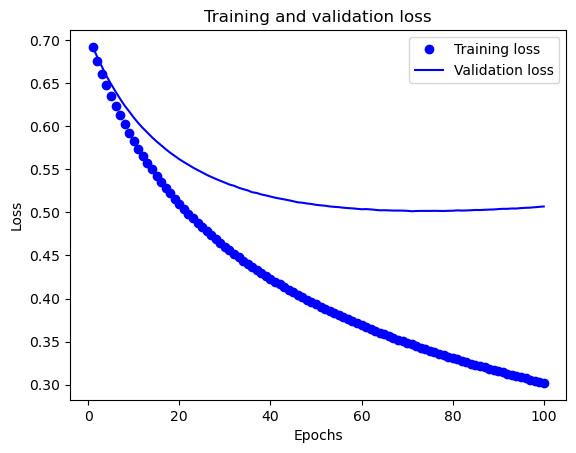

In [80]:
import matplotlib.pyplot as plt

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(loss) + 1)

plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

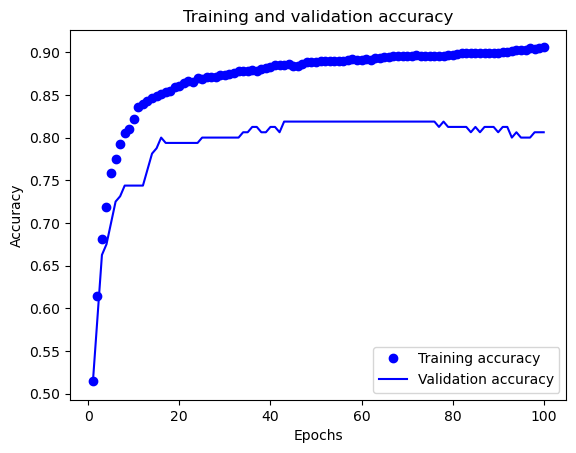

In [83]:
plt.clf()
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
plt.plot(epochs, acc, 'bo', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [84]:
model.fit(x_train.A, y_train, epochs=3, validation_split=0.1,
          callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_accuracy')])

Epoch 1/3
45/45 [==============================] - 0s 7ms/step - loss: 0.3008 - accuracy: 0.9049 - val_loss: 0.5074 - val_accuracy: 0.8062
Epoch 2/3
45/45 [==============================] - 0s 9ms/step - loss: 0.2996 - accuracy: 0.9069 - val_loss: 0.5075 - val_accuracy: 0.8062
